In [130]:
using Images, ImageDraw
using Colors
using FileIO
using Interpolations
using Plots

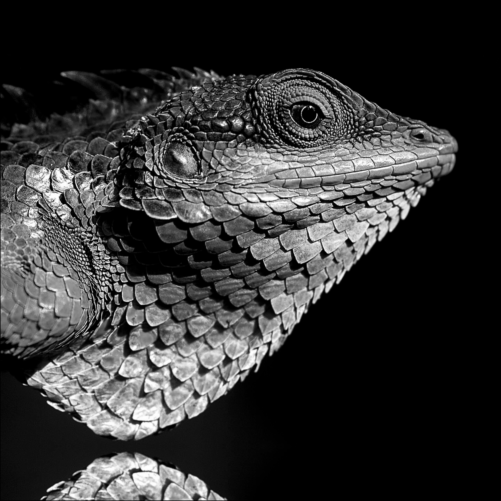

In [131]:
# specify the path to your local image file and load it:
img_path = "./images/input/lizard.jpg"
img = load(img_path)
img_grey = Gray{Float32}.(img)

# Hough transform most simple example

detecting just a few lines:


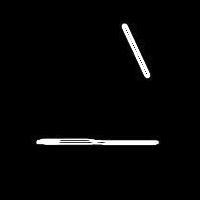

In [132]:
include("imageops.jl")
img = load("./images/input/geom2.jpg")
img = Gray{Float32}.(img)
img = sobel(img)

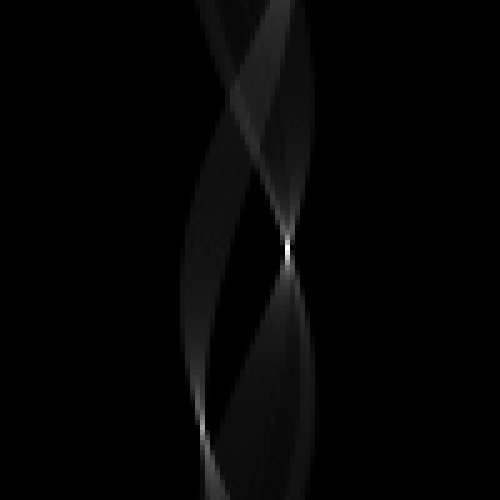

In [133]:
acc_matrix = hough_transform_accumulator_matrix(img, (100, 100))
imresize(Gray.(acc_matrix), (500, 500), method=Interpolations.Constant())

In [134]:
top_k_line_params = top_k_line_params_from_acc_matrix(acc_matrix, 10, size(img))

(phi, r, m, n) = (2.638937829015426, -50.911688126222145, 1.8189932472810648, -105.67991665274326)
(phi, r, m, n) = (1.5079644737231006, 45.2548341151483, -0.0629146672536499, 45.34431075449977)
(phi, r, m, n) = (2.73318560862312, -50.911688126222145, 2.3108636538824108, -128.19327340464415)
(phi, r, m, n) = (2.670353755551324, -50.911688126222145, 1.9626105055051501, -112.14262887754269)
(phi, r, m, n) = (1.6650441064025905, 45.2548341151483, 0.09452783117928212, 45.456571990665516)
(phi, r, m, n) = (2.701769682087222, -50.911688126222145, 2.125108173157201, -119.5729551314761)
(phi, r, m, n) = (1.5393804002589986, 45.2548341151483, -0.03142626604335125, 45.2771756681507)
(phi, r, m, n) = (1.6336281798666925, 45.2548341151483, 0.06291466725364979, 45.34431075449977)
(phi, r, m, n) = (1.6022122533307945, 45.2548341151483, 0.03142626604335113, 45.2771756681507)
(phi, r, m, n) = (1.5707963267948966, 45.2548341151483, -6.123233995736766e-17, 45.2548341151483)


10-element Vector{Tuple{Float64, Float64}}:
 (1.8189932472810648, -105.67991665274326)
 (-0.0629146672536499, 45.34431075449977)
 (2.3108636538824108, -128.19327340464415)
 (1.9626105055051501, -112.14262887754269)
 (0.09452783117928212, 45.456571990665516)
 (2.125108173157201, -119.5729551314761)
 (-0.03142626604335125, 45.2771756681507)
 (0.06291466725364979, 45.34431075449977)
 (0.03142626604335113, 45.2771756681507)
 (-6.123233995736766e-17, 45.2548341151483)

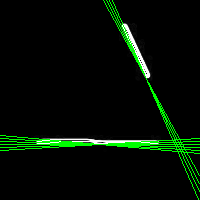

In [135]:
function plot_img_and_linear_functions(img, mn_list)
    img2 = RGB{Float32}.(copy(img))
    (h, w) = size(img)

    for (m, n) in mn_list
        if abs(n) < 1e16

            x1 = -w ÷ 2
            x2 = w ÷ 2

            y1 = floor(Int, m * x1 + n)
            y2 = floor(Int, m * x2 + n)

            (x1, y1) = rel_pos_to_abs((x1, y1), (w, h))
            (x2, y2) = rel_pos_to_abs((x2, y2), (w, h))
            draw!(img2, LineTwoPoints(Point(x1, y1), Point(x2, y2)), RGB{Float32}(0.0, 1.0, 0.0))
        end
    end
    return img2
end


plot_img_and_linear_functions(img, top_k_line_params)

(phi, r, m, n) = (1.6022122533307945, 45.2548341151483, 0.03142626604335113, 45.2771756681507)
(phi, r, m, n) = (1.5707963267948966, 45.2548341151483, -6.123233995736766e-17, 45.2548341151483)


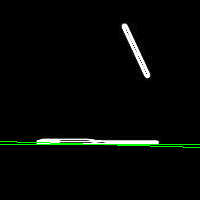

In [136]:
top_k_line_params = top_k_line_params_from_acc_matrix(acc_matrix, 2, size(img))
plot_img_and_linear_functions(img, top_k_line_params)

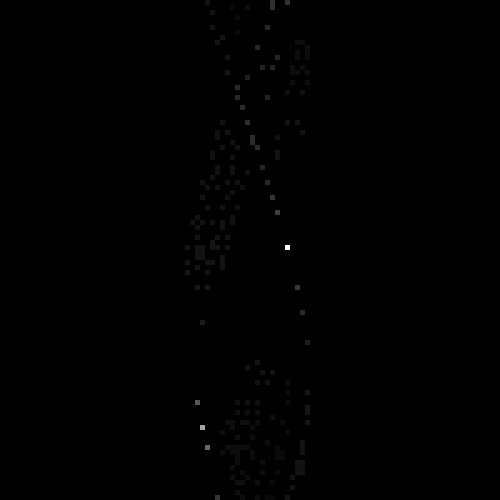

In [137]:
suppressed_acc_matrix = non_maximum_suppression(acc_matrix)
imresize(Gray.(suppressed_acc_matrix), (500, 500), method=Interpolations.Constant())

(phi, r, m, n) = (2.701769682087222, -50.911688126222145, 2.125108173157201, -119.5729551314761)
(phi, r, m, n) = (1.5707963267948966, 45.2548341151483, -6.123233995736766e-17, 45.2548341151483)


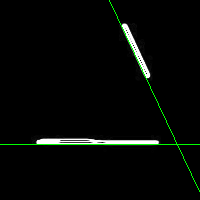

In [138]:
top_k_line_params = top_k_line_params_from_acc_matrix(suppressed_acc_matrix, 2, size(img))
plot_img_and_linear_functions(img, top_k_line_params)

## detecting the edges of some shapes

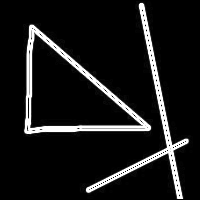

In [139]:
include("imageops.jl")
img = load("./images/input/geom.jpg")
img = Gray{Float32}.(img)
img = sobel(img)

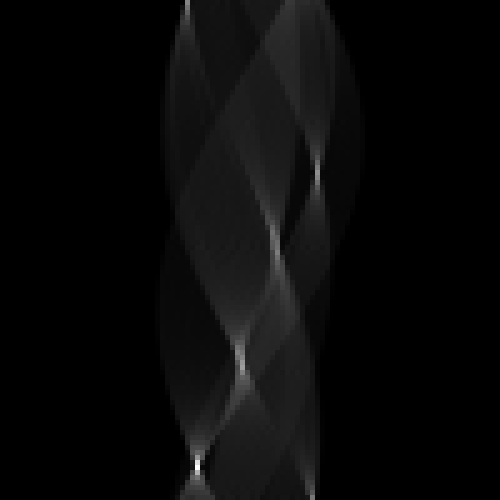

In [140]:
acc_matrix = hough_transform_accumulator_matrix(img, (100, 100))
imresize(Gray.(acc_matrix), (500, 500), method=Interpolations.Constant())

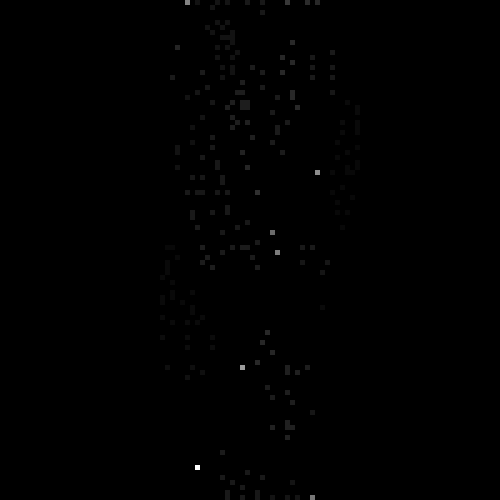

In [141]:
acc_matrix = non_maximum_suppression(acc_matrix)
imresize(Gray.(acc_matrix), (500, 500), method=Interpolations.Constant())

(phi, r, m, n) = (1.6022122533307945, 33.94112561616362, 0.03142626604335113, 33.95788178093013)
(phi, r, m, n) = (0.031415926535897934, -67.88225087469928, -31.82051595377396, -2161.1146265473903)
(phi, r, m, n) = (1.0995574287564276, 79.19595961210263, -0.5095254494944289, 88.88370338729393)
(phi, r, m, n) = (2.324778563656447, -5.6568541302830795, 0.9390625058174926, -7.760078990358104)
(phi, r, m, n) = (2.9530970943744053, -56.568542375714514, 5.242183581113166, -301.8899856732246)


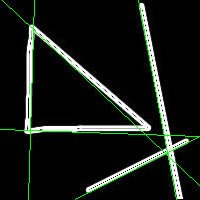

In [142]:
top_k_line_params = top_k_line_params_from_acc_matrix(acc_matrix, 5, size(img))
plot_img_and_linear_functions(img, top_k_line_params)

In [143]:
function plot_img_and_points(img, points; rel=false)
    img2 = RGB{Float32}.(copy(img))
    (h, w) = size(img)

    for (x, y) in points
        try
            if rel
                x = floor(Int, x)
                y = floor(Int, y)
                (x, y) = rel_pos_to_abs((x, y), (w, h))
            end
            draw!(img2, Ellipse(CirclePointRadius(x, y, 6; thickness=4, fill=false)), RGB{Float32}(1.0, 0.0, 1.0))
        catch
        end
    end
    return img2
end

plot_img_and_points (generic function with 1 method)

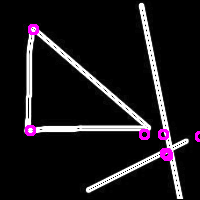

In [144]:
points = line_params_to_corner_points(top_k_line_params)
plot_img_and_points(img, points, rel=true)

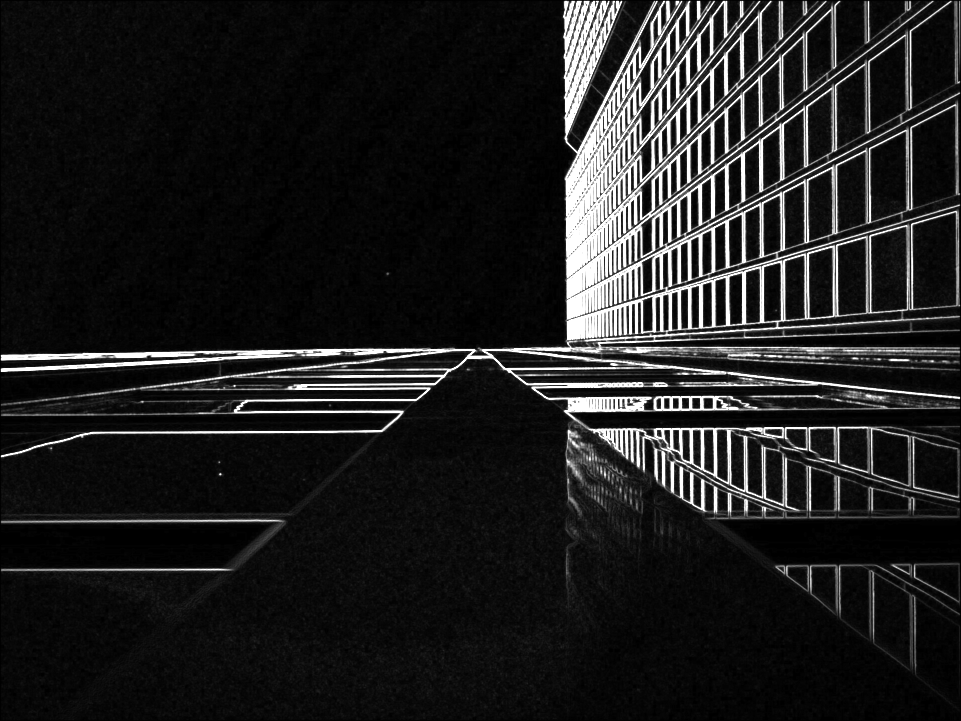

In [145]:
include("imageops.jl")
img = load("./images/input/house.jpg")
img = Gray{Float32}.(img)
img = sobel(img)

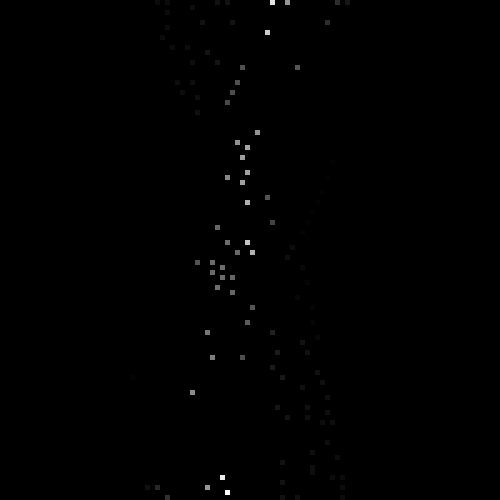

In [146]:
acc_matrix = hough_transform_accumulator_matrix(img, (100, 100))
acc_matrix = non_maximum_suppression(acc_matrix)
imresize(Gray.(acc_matrix), (500, 500), method=Interpolations.Constant())

In [147]:
line_params = line_params_from_acc_matrix(acc_matrix, Float32(0.25), size(img))

(phi, r, m, n) = (2.4818581963359367, -527.9999998807907, 1.289192231785067, -861.4683037727618)
(phi, r, m, n) = (1.6650441064025905, -479.9999998807907, 0.09452783117928211, -482.1397531716287)
(phi, r, m, n) = (2.1048670779051615, -383.9999998807907, 0.5913983513994712, -446.12669979344616)
(phi, r, m, n) = (3.078760800517997, -383.9999998807907, 15.894544843865251, -6115.572904306379)
(phi, r, m, n) = (1.6650441064025905, -335.9999998807907, 0.09452783117928211, -337.49782718421784)
(phi, r, m, n) = (1.7278759594743864, -335.9999998807907, 0.1583844403245365, -340.18828214407375)
(phi, r, m, n) = (2.261946710584651, -335.9999998807907, 0.8272719459724758, -436.07297217935417)
(phi, r, m, n) = (1.4451326206513049, -287.9999998807907, -0.12632937844610817, -290.2890154729208)
(phi, r, m, n) = (1.82212373908208, -287.9999998807907, 0.2567563603677266, -297.3415308451179)
(phi, r, m, n) = (1.6964600329384885, -239.9999998807907, 0.1263293784461083, -241.9075128740746)
(phi, r, m, n) = 

40-element Vector{Tuple{Float64, Float64}}:
 (1.289192231785067, -861.4683037727618)
 (0.09452783117928211, -482.1397531716287)
 (0.5913983513994712, -446.12669979344616)
 (15.894544843865251, -6115.572904306379)
 (0.09452783117928211, -337.49782718421784)
 (0.1583844403245365, -340.18828214407375)
 (0.8272719459724758, -436.07297217935417)
 (-0.12632937844610817, -290.2890154729208)
 (0.2567563603677266, -297.3415308451179)
 (0.1263293784461083, -241.9075128740746)
 ⋮
 (0.03142626604335113, 48.02369691465107)
 (0.3959280087977213, 51.62531086528074)
 (-0.881618592363189, 127.98104708213873)
 (-4.473742829211554, 880.1556210957282)
 (-0.32491969623290634, 201.88074717909137)
 (-31.820515953773963, 7640.694053978604)
 (-0.15838444032453636, 242.99163030981595)
 (-31.820515953773963, 12225.110484088662)
 (-2.125108173157202, 1127.3446351860678)

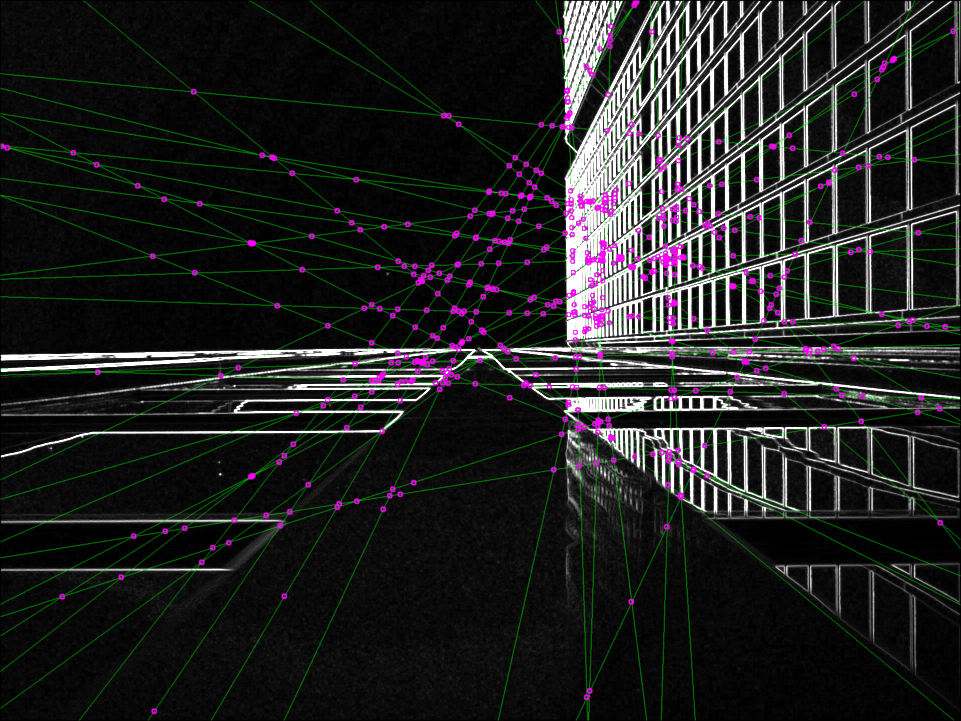

In [148]:
img2 = plot_img_and_linear_functions(img, line_params)
points = line_params_to_corner_points(line_params)

plot_img_and_points(img2, points, rel=true)

these cornerpoints are obviously pointless. The lines and points are dominated by the region in the top left part.


# Corner Detection with Harris Corner Detector

In [149]:
include("imageops.jl")
img = load("./images/input/geom.jpg")
img = Gray{Float32}.(img)
img = sobel(img)
points = harris_corner_detector(img, alpha=0.1, threshold=0.2, min_dist=10)

9-element Vector{Any}:
 (182, 198)
 (168, 155)
 (173, 145)
 (31, 128)
 (142, 5)
 (36, 35)
 (141, 125)
 (88, 191)
 (187, 141)

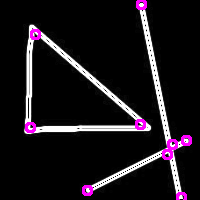

In [150]:
plot_img_and_points(img, points, rel=false)


971 detected in image

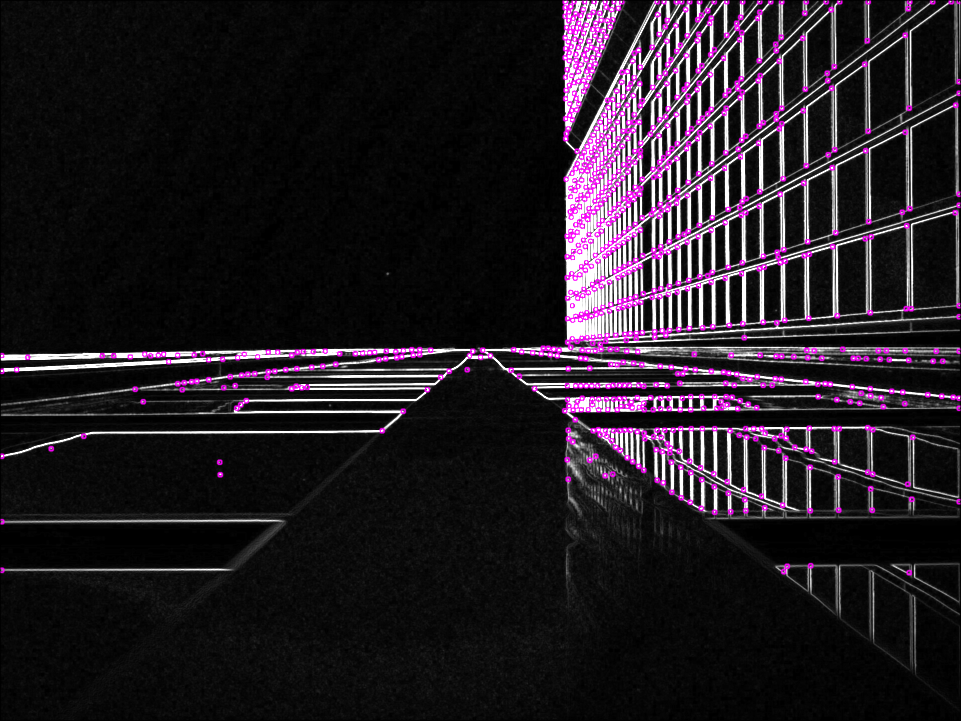

In [152]:
img = load("./images/input/house.jpg")
img = Gray{Float32}.(img)
img = sobel(img)
points = harris_corner_detector(img, alpha=0.1, threshold=0.2, min_dist=10)
print("$(length(points)) detected in image")
plot_img_and_points(img, points, rel=false)


# Hough Transform for finding Circles

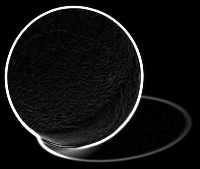

In [153]:
include("imageops.jl")
img = load("./images/input/ball.jpg")
img = Gray{Float32}.(img)
img = sobel(img)

In [154]:
acc_matrix = hough_transform_accumulator_matrix_for_circles(img, (32, 32, 32))
circle_params = top_k_circles_from_acc_matrix(acc_matrix, 3, size(img))

3-element Vector{Tuple{Float64, Float64, Float64}}:
 (75.0, 79.21875, 73.64293738412734)
 (68.75, 79.21875, 73.64293738412734)
 (81.25, 79.21875, 73.64293738412734)

In [155]:
function plot_img_and_circles(img, circle_params)

    (h, w) = size(img)
    images = []
    for (x, y, r) in circle_params
        x, y, r = floor(Int, x), floor(Int, y), floor(Int, r)
        @show x, y, r

        color = (1.0, 0.0, 0.0)
        img_circle = RGB{Float32}.(zeros(size(img)))
        draw!(img_circle, Ellipse(CirclePointRadius(x, y, r; thickness=2, fill=true)), RGB{Float32}(color[1], color[2], color[3]))
        draw!(img_circle, Ellipse(CirclePointRadius(x, y, r - 3; thickness=2, fill=true)), RGB{Float32}(0.0, 0.0, 0.0))
        push!(images, img_circle)
    end
    img2 = RGB{Float32}.(copy(img)) * 0.8
    for i in images
        img2 .+= i
    end
    return img2
end

plot_img_and_circles (generic function with 1 method)

(x, y, r) = (75, 79, 73)
(x, y, r) = (68, 79, 73)
(x, y, r) = (81, 79, 73)


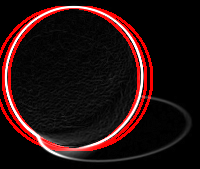

In [156]:
plot_img_and_circles(img, circle_params)

(x, y, r) = (75, 79, 73)


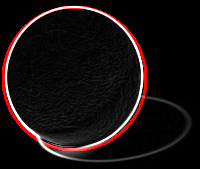

In [157]:
plot_img_and_circles(img, [circle_params[1]])

## On a real life image of a cricle

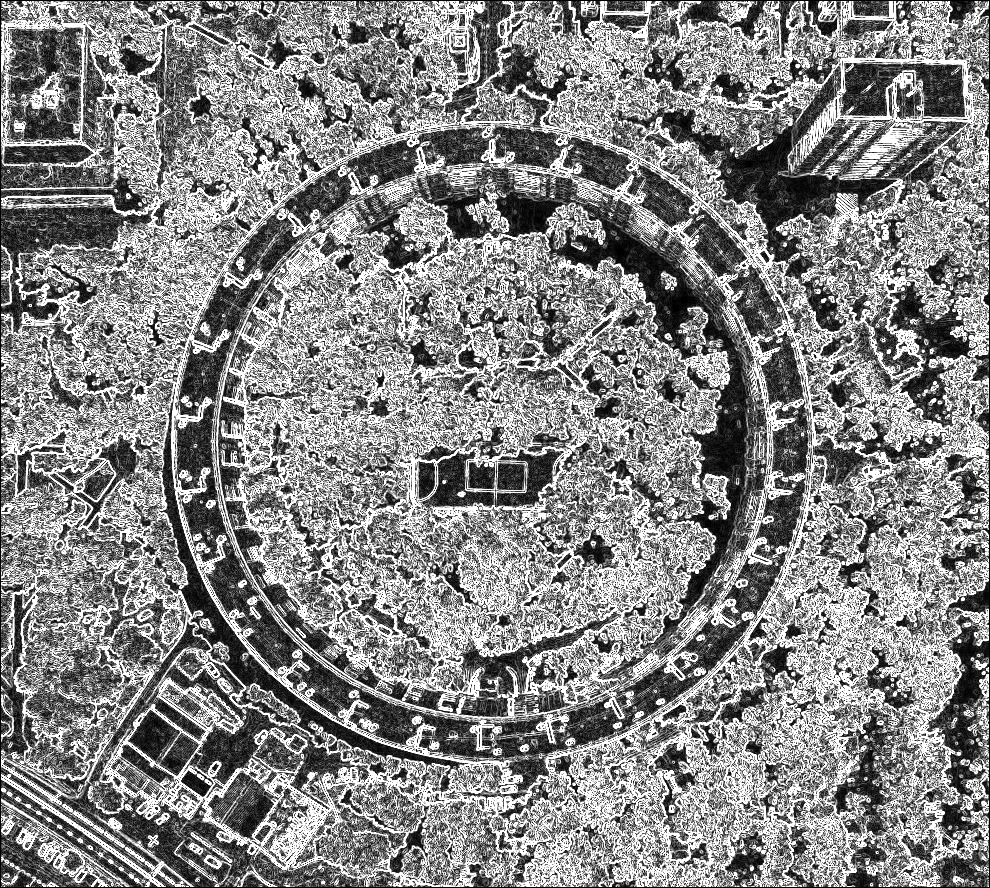

In [158]:
include("imageops.jl")
original = load("./images/input/circle_air_view.jpg")
img = Gray{Float32}.(original)
img = sobel(img)

(x, y, r) = (525, 444, 415)


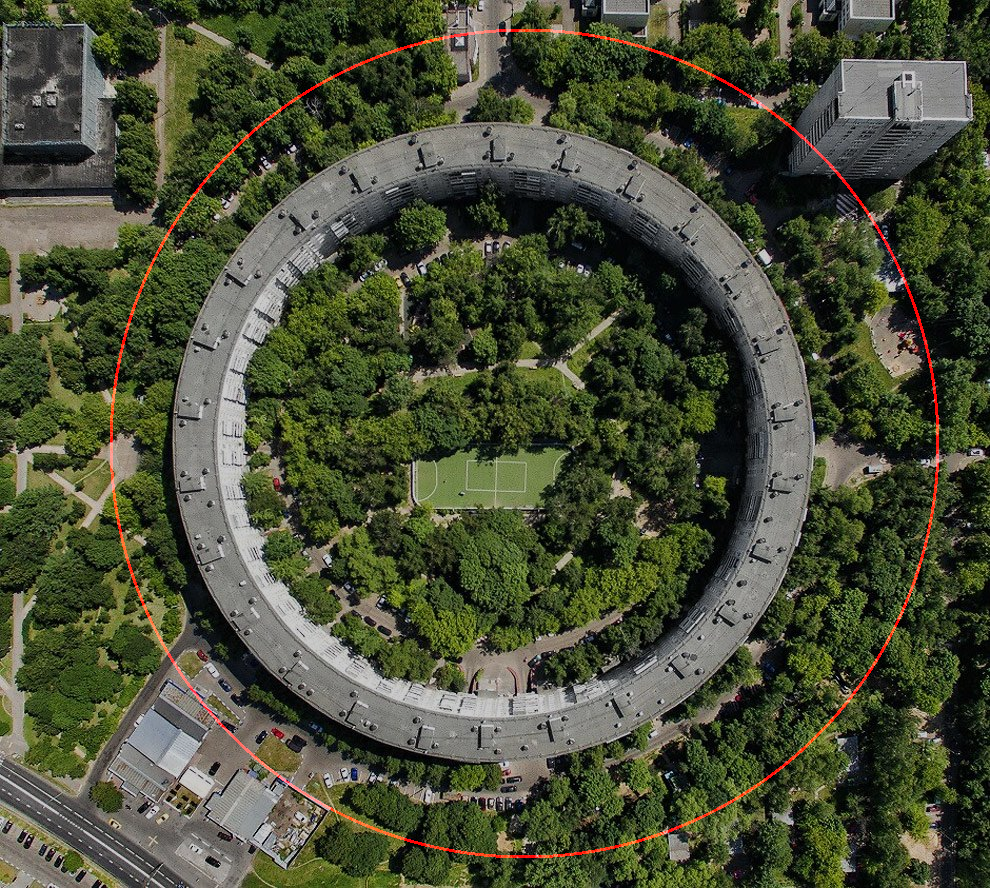

In [159]:
acc_matrix = hough_transform_accumulator_matrix_for_circles(img, (32, 32, 32))
circle_params = top_k_circles_from_acc_matrix(acc_matrix, 1, size(img))
plot_img_and_circles(original, circle_params)

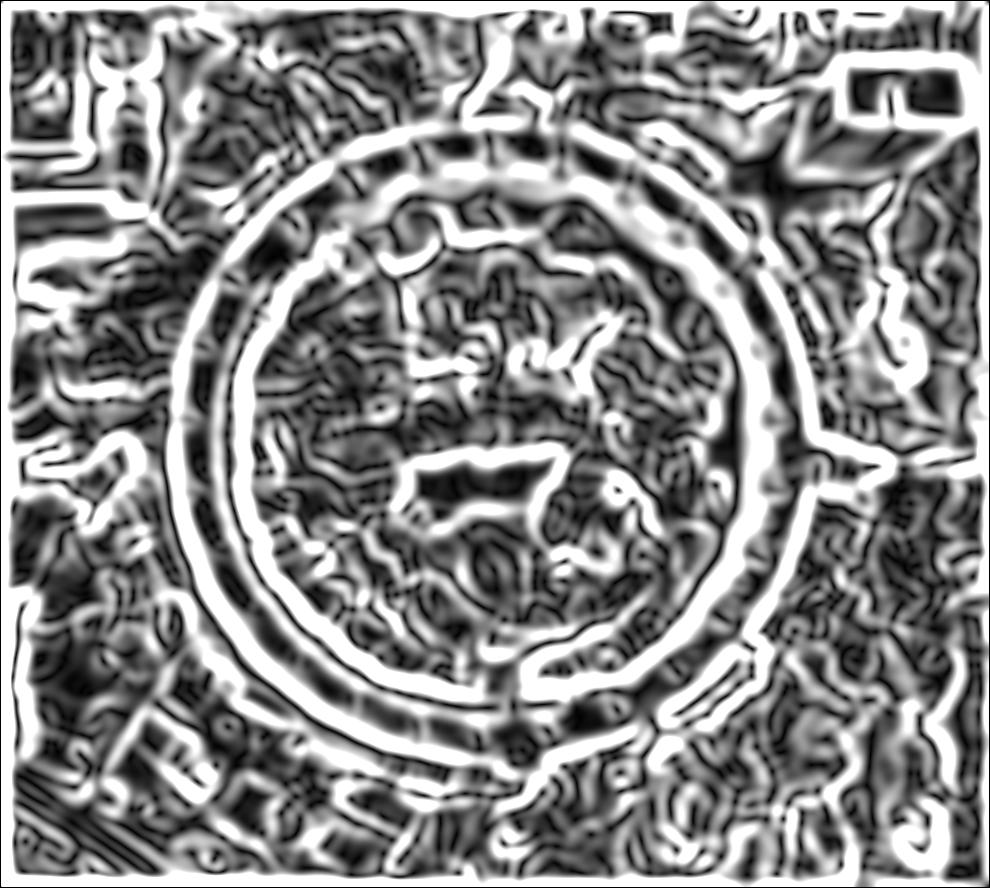

In [160]:
function smoothx(img, x)
    e = smooth(img)
    for i in 2:x
        e = smooth(e)
    end
    return e
end

img = sobel(smoothx(Gray{Float32}.(original), 100))
img = img * 8

(x, y, r) = (495, 444, 332)


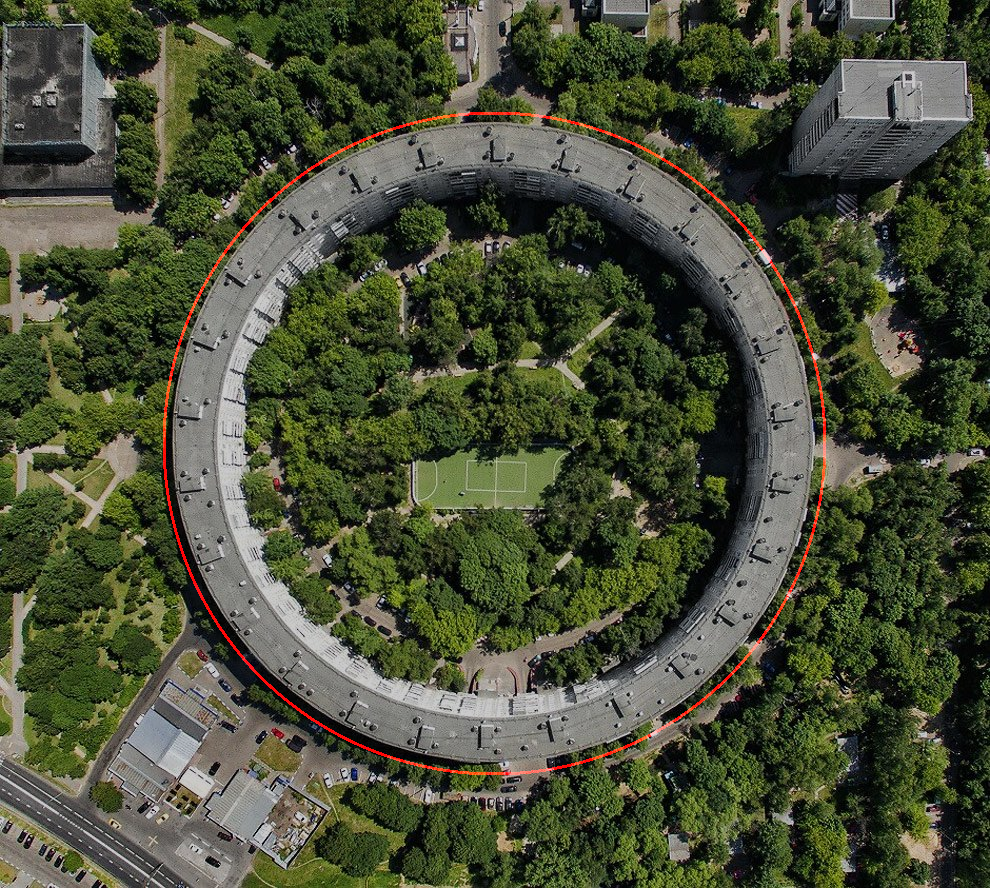

In [161]:
acc_matrix = hough_transform_accumulator_matrix_for_circles(img, (32, 32, 32))
circle_params = top_k_circles_from_acc_matrix(acc_matrix, 1, size(img))
plot_img_and_circles(original, circle_params)

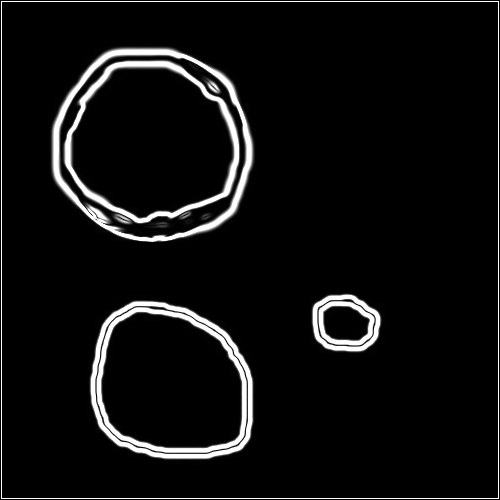

In [162]:
include("imageops.jl")
original = load("./images/input/circles.jpg")
img = Gray{Float32}.(original)
img = sobel(smooth(img))

(x, y, r) = (171, 390, 88)
(x, y, r) = (140, 140, 88)
(x, y, r) = (156, 140, 88)
(x, y, r) = (187, 250, 198)


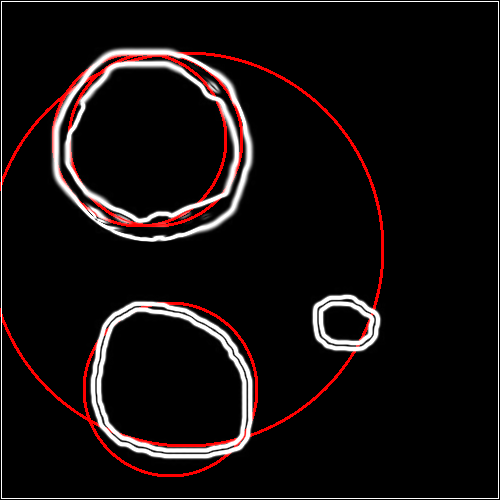

In [163]:
acc_matrix = hough_transform_accumulator_matrix_for_circles(img, (32, 32, 32))
circle_params = top_k_circles_from_acc_matrix(acc_matrix, 10, size(img))
plot_img_and_circles(img, circle_params[1:4])

## Runtime analysis

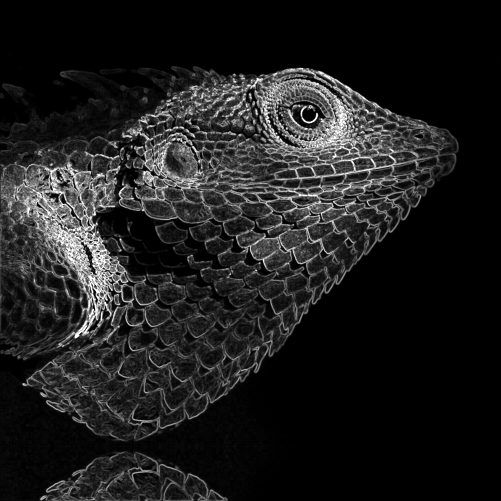

In [168]:
# Hough transform on 4000 x 4000
include("imageops.jl")
original = load("./images/input/lizard.jpg")
img = Gray{Float32}.(original)
img = sobel(smooth(img))

In [165]:
@time  hough_transform_accumulator_matrix(img, (32, 32), Float32(0.8))



  0.279342 seconds (132.29 k allocations: 2.031 MiB)


32×32 Matrix{Float32}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 ⋮                        ⋮              ⋱  ⋮                        ⋮    
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     

In [166]:
@time  hough_transform_accumulator_matrix(img, (32, 32), Float32(0.4))

  1.191418 seconds (378.96 k allocations: 5.795 MiB)


32×32 Matrix{Float32}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 ⋮                        ⋮              ⋱  ⋮                        ⋮    
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     

11462

 10.562628 seconds (117.22 M allocations: 3.619 GiB, 10.82% gc time, 0.26% compilation time)
3655 points detected

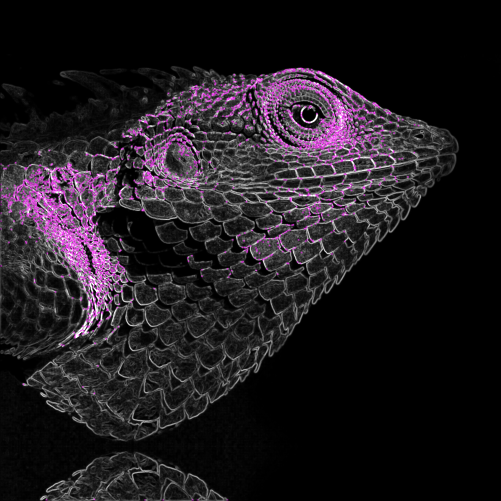

In [169]:
@time points =harris_corner_detector(img, alpha=0.1, threshold=0.2, min_dist=10)
print("$(length(points)) points detected")
plot_img_and_points(img, points, rel=false)